<a href="https://colab.research.google.com/github/gus474/Mosquito-Audio-Recognition-ML-III/blob/main/EBS_Supervised_ML_IV.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

The objective of this research is to classify mosquito species based on audio recordings using cell phones. The data I used originates from a paper called [*Using mobile phones as acoustic sensors for high-throughput mosquito surveillance* by Markundarajan et al. (2017)](https://elifesciences.org/articles/27854#s4). Side note: If you haven't seen the work of the Prakash Lab at Stanford, such as the [FoldoScope](https://www.foldscope.com/), you **have to** check it out!!

<center>
<img src='https://iiif.elifesciences.org/lax/27854%2Felife-27854-fig1-v1.tif/full/1234,/0/default.webp' width=500>
</center>
<br>

Here's a passage from the paper that will help motivate this idea:

> Frequent, widespread, and high resolution surveillance of mosquitoes is essential to understanding their complex ecology and behaviour. An in-depth knowledge of human—mosquito interactions is a critical component in mitigating mosquito-borne diseases like malaria, dengue, and Zika (Macdonald, 1956; World Health Organization, 2014; Godfray, 2013; Besansky, 2015; Kindhauser et al., 2016). However, there is a paucity of high-resolution ecological data on the abundance, temporal variation, and spatial distribution of mosquito vector species. This poses a serious impediment to the effective control of mosquito-borne diseases (Townson et al., 2005; Ferguson et al., 2010; Hay et al., 2013). Efforts to map mosquito populations primarily rely on interpolative mathematical models based on factors such as clinical disease burdens or climatological data, with field inputs from entomological surveys being a comparatively sparse contribution (Hay et al., 2010; Mordecai et al., 2017). This scarcity of field data stems from the absence of high-throughput, low-cost surveillance techniques to map the distribution of mosquitoes. This effect is particularly severe in resource-constrained areas, as currently used methods like trapping and manual identification require considerable expense, labour, and time. However, for disease control strategies to be truly effective, it is critical for them to be strongly informed by current mosquito population distributions. Hence, there is a pressing need for novel methods of surveillance that can rapidly and inexpensively sample mosquito populations across large areas at high spatio-temporal resolutions.

> Acoustic surveillance was proposed decades ago as a high-throughput automated surveillance approach, where mosquitoes in flight are identified using the species-specific frequencies in their wingbeat sounds (Kahn et al., 1945; Kahn and Offenhauser, 1949a; Offenhauser and Kahn, 1949; Kahn and Offenhauser, 1949b; Jones, 1964; Johnson and Ritchie, 2016). This technique is based on the hypothesis that sexual selection has led to characteristic sound signatures for different mosquito species (Roth, 1948; Belton, 1994; Gibson and Russell, 2006; Cator et al., 2009; Warren et al., 2009; Pennetier et al., 2010; Cator et al., 2010). However, the challenge of using expensive microphones to acquire low amplitude mosquito sounds against potentially high background noise poses a significant barrier to its widespread adoption as a field technique (Jones, 1964; Unwin and Ellington, 1979; Raman et al., 2007). Optical wingbeat measurement has been proposed as a proxy for sound recording, to overcome the technological limitations in audio signal acquisition (Moore et al., 1986; Batista et al., 2011; Chen et al., 2014; Silva et al., 2015). However, this approach is yet to take flight on a large scale, as the cost and global scalability of the requisite hardware remain challenges for its worldwide deployment.

> Here, I propose a novel solution that uses mobile phones to enable widespread acoustic mosquito surveillance. I use the sensitive microphones in mobile handsets to record species-specific wingbeat sounds from a variety of mosquito vector species for automated identification and analysis. This technique exploits the rapid advances in mobile phone hardware technology, recognizing that these highly portable devices are optimized for sophisticated audio capture, processing, and transmission. Further, the proliferation of the global mobile network implies that around 5.3 billion users worldwide are connected today by a distributed data transmission infrastructure, growing quickly at over 6% annually (Cerwall et al., 2017). Mobile connectivity has revolutionized the delivery of services based on mapping and analyzing crowdsourced data from mobile phones, which has enabled many innovative applications in citizen science (Graham et al., 2011; Catlin-Groves, 2012; Malykhina, 2013; Kong et al., 2016). Also, the explosive growth in mobile phone use is most pronounced in Africa, Asia, and Latin America (Cerwall et al., 2017), which also bear the brunt of mosquito-borne diseases (World Health Organization, 2014). This overlap implies that a mobile phone based concept can be particularly scalable, sustainable, and cost effective for sampling real-time mosquito population dynamics in resource-constrained areas with high disease burdens. My proof-of-concept study highlights the potential of this solution to engage citizen scientists around the world in mosquito surveillance, without the need for specialized equipment or extensive formal training.

Within the `data_mosquito` directory that I've linked, there will be a subset of their recordings that I use to classify which of 5 mosquito species is producing a unique buzzzzzzzzzzzz.

#### Importing libraries

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
import os
from IPython.display import Audio
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import librosa
from scipy.io import wavfile
from scipy import signal
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import RFECV
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import accuracy_score, plot_confusion_matrix
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier

#### Loading one sample audio file from each species (index = 10), then plotting each sound wave, and listening to each in my Colab Notebook.

In [ ]:
path = []

ipath = '/content/drive/MyDrive/Electrical-Biosystems-Engineering-Laboratory-A189-Tempory-Audio/Insect-Maturity-Week/Classification/data_mosquito/'
fivenames = os.listdir(ipath) #Assigning the names of each type of file name within path.
for i in (fivenames):

  path.append(str(ipath) + str(i) + '/') #adding an additional / after each speacies folder to find the file names of each recording within.
  d = (str(ipath) + str(i))
  if i == 'Culiseta incidens':
    ci = (os.listdir(d))
  elif i == 'Aedes aegypti':
    aa = (os.listdir(d))
  elif i == 'Aedes sierrensis':
    aes = (os.listdir(d))
  elif i == 'Anopheles freeborni': #sorting species file path by name into their respective variables.
    af = (os.listdir(d))
  else:
    ag = (os.listdir(d))
path

['/content/drive/MyDrive/EBS189A_TEMPLATES/Week 06 - Classification/data_mosquito/Culiseta incidens/',
 '/content/drive/MyDrive/EBS189A_TEMPLATES/Week 06 - Classification/data_mosquito/Aedes aegypti/',
 '/content/drive/MyDrive/EBS189A_TEMPLATES/Week 06 - Classification/data_mosquito/Aedes sierrensis/',
 '/content/drive/MyDrive/EBS189A_TEMPLATES/Week 06 - Classification/data_mosquito/Anopheles freeborni/',
 '/content/drive/MyDrive/EBS189A_TEMPLATES/Week 06 - Classification/data_mosquito/Anopheles gambiae/']

In [ ]:
oslistdr = np.array([ci, aa, aes, af, ag]) #listing them all into one variable for easy iteration in the future.
#len(oslistdr)
#len(ag)
#fivenames

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  """Entry point for launching an IPython kernel.


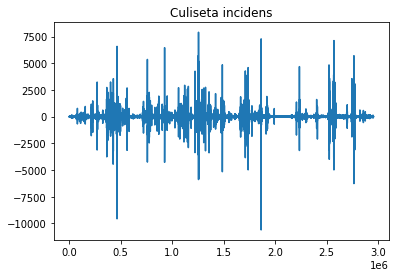

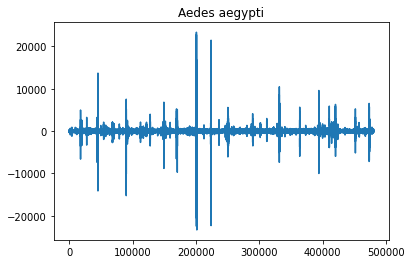

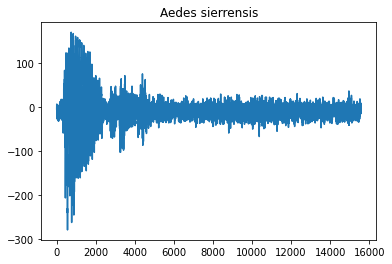

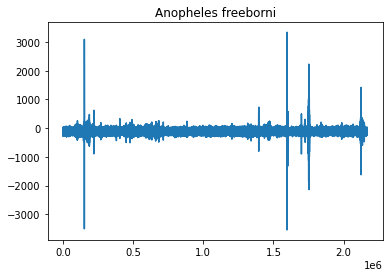

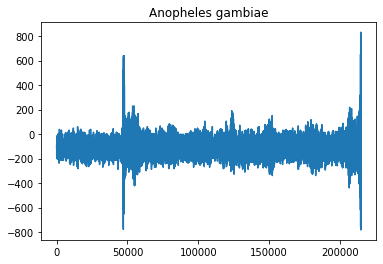

In [ ]:
wavelist = []
srlist = []


for i,name in enumerate(path): #Iterating for each species sound wave plot.
  sr, wave = wavfile.read(name + oslistdr[i][10])
  wavelist.append(wave)
  srlist.append(sr)
  #Audio(wave, rate = sr)
  plt.plot(np.arange(0,wave.shape[0]), wave)
  plt.title(str(fivenames[i]))
  #plt.xlabel('Frequency')
  plt.show()


#sr, wave = wavfile.read(ag + e[10])
#plt.plot(np.arange(0,wave.shape[0]), wave)
#plt.xlabel()

In [ ]:
##agname = os.listdir('/content/drive/MyDrive/EBS189A_TEMPLATES/Week 06 - Classification/data_mosquito/Anopheles gambiae')
#aaname = os.listdir('/content/drive/MyDrive/EBS189A_TEMPLATES/Week 06 - Classification/data_mosquito/Aedes aegypti')
#aesname = os.listdir('/content/drive/MyDrive/EBS189A_TEMPLATES/Week 06 - Classification/data_mosquito/Aedes sierrensis')
#afname = os.listdir('/content/drive/MyDrive/EBS189A_TEMPLATES/Week 06 - Classification/data_mosquito/Anopheles freeborni')
#ciname = os.listdir('/content/drive/MyDrive/EBS189A_TEMPLATES/Week 06 - Classification/data_mosquito/Culiseta incidens')

#agpath = '/content/drive/MyDrive/EBS189A_TEMPLATES/Week 06 - Classification/data_mosquito/Anopheles gambiae/'
#aapath = '/content/drive/MyDrive/EBS189A_TEMPLATES/Week 06 - Classification/data_mosquito/Aedes aegypti/'
#aespath = '/content/drive/MyDrive/EBS189A_TEMPLATES/Week 06 - Classification/data_mosquito/Aedes sierrensis/'
#afname = '/content/drive/MyDrive/EBS189A_TEMPLATES/Week 06 - Classification/data_mosquito/Anopheles freeborni/'
#cipath = '/content/drive/MyDrive/EBS189A_TEMPLATES/Week 06 - Classification/data_mosquito/Culiseta incidens/'

srlist[0]

44100

In [ ]:
#Culiseta incidens 10th-index recording.
Audio(data = wavelist[0], rate = srlist[0])

In [ ]:
#10th-index recording of Aedes aegypti
Audio(data = wavelist[1], rate = srlist[1])

In [ ]:
#10th index recording of Aedes sierrensis
Audio(data = wavelist[2], rate = srlist[2])

In [ ]:
#10th index recording of Anopheles freeborni
Audio(data = wavelist[3], rate = srlist[3])

In [ ]:
#10th index recording of Anopheles gambiae
Audio(data = wavelist[4], rate = srlist[4])

#### Loading the train audio + label datasets
- For each wave file, I generate four final outputs:
 - `sg_list`: A list containing a spectrogram for each audio file
 - `f_list`: A list containing a vector of frequency bins for each spectrogram
 - `t_list`: A list containing a vector of time bins for each spectrogram  
 - `y_list`: A list containing a vector of the mosquito species corresponding with each spectrogram
- If the sampling rate of a given audio file is not `8000` hz, I use the`resample()` function within the `librosa` library to resample the audio file to `8000` hz.
 - I convert the input wave file using `np.float32()`. The `librosa.resample()` function requires a 32-bit float input.
 - I set the original sampling rate argument, `orig_sr`, to the sampling rate of my wave file
 - I set the target sampling rate argument, `target_sr`, to `8000`
 - I set the resampling type argument, `rs_type`, to `polyphase`. This resampling algorithm is chosen because it is relatively fast.
- When generating the spectrogram using `signal.spectrogram()` from the `scipy` library, I set the `nfft` argument equal to `1000`. A larger `nfft` value effectively smoothes the spectrogram over the frequency domain, resulting in more frequency bins.
- Previous studies have observed mosquito wingbeat frequencies to be less than 2000 hz. In each spectrogram, `sg_list[i]` filter out any frequency bins greater than 2000 hz. Remember: `f_list[i]` contains the frequency bin info.
- Loading all the files takes about 3 mins for me. Side note (if you attempt): Consider saving them as numpy files using `np.save()` for quicker loading when your runtime shuts down.
- Don't worry if you run receive warnings while running your function, they won't cause any actual issues!

In [ ]:
sg_list = [] #Creating empty lists
f_list = []
t_list = []
y_list = []
audio_list = []
rs_type = 'polyphase'
target_sr = 8000
for i, name in enumerate(path): #Function to assort the lists values of frequency, time, corresponding response variables, etc.
  for j in range(0, len(oslistdr[i][:])): #Iterating through all observations within a given species.
    sr, wave = wavfile.read(name + oslistdr[i][j])
    wave = np.float32(wave) #Conversion to 32 bit data.
    if sr != 8000:
      dummy = librosa.resample(wave, sr, target_sr, res_type = 'polyphase')
    f, t, Sxx = signal.spectrogram(dummy, fs = target_sr, nfft= 1000)
    audio_list.append(dummy)
    sg_list.append(Sxx[f<= 2000])
    f_list.append(f[f<= 2000])
    y_list.append(fivenames[i])
    t_list.append(t)

#for i,name in enumerate(path):
  #print(name + str(e[i]))
  #sr, wave = wavfile.read(name + e[i])





/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: WavFileWarning: Chunk (non-data) not understood, skipping it.
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: WavFileWarning: Reached EOF prematurely; finished at 13440044 bytes, expected 13440052 bytes from header.
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: WavFileWarning: Reached EOF prematurely; finished at 21719084 bytes, expected 21719092 bytes from header.
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: WavFileWarning: Reached EOF prematurely; finished at 5806124 bytes, expected 5806132 bytes from header.
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: WavFileWarning: Reached EOF prematurely; finished at 7741484 bytes, expected 7741

#### Visualizing spectrograms and listening to audio

- I create visualizations of the spectrogram for samples with index values of `50` and `200`
- I've set `vmin=0` and `vmax=100` in `plt.pcolormesh()`
- *I've noticed a few distinct frequency bands that correspond to a mosquito species. The frequency tends to be denser in occurence when it the mosquitos are quite close to the phone mic, thus as the volume goes up, so does the denisty of the plot. Also interestingly bands near 575, 1175, and 1775 (Hz) seem to occur the most often, corresponding to the mosquito specie, Aedes Aegypti.*

Text(0.5, 1.0, 'Aedes aegypti')

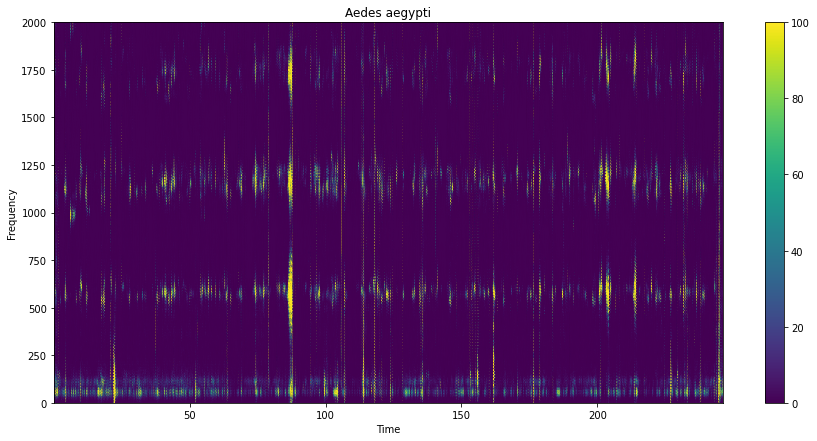

In [ ]:
plt.figure(figsize= (15, 7))
plt.pcolormesh(t_list[50], f_list[50], sg_list[50], vmin=0, vmax = 100, shading= 'gouraud')
plt.xlabel('Time')
plt.ylabel('Frequency')
plt.colorbar()
plt.title(str(y_list[50])) #The frequency tends to be denser in occurence when it the mosquitos are quite close to the phone mic.
#As the volume goes up, so does the denisty of the plot. Also interestingly bands near 575, 1175, and 1775 (Hz) seem to
#occur the most often. The corresponding mosquito specie is Aedes Aegypti.



In [ ]:
Audio(data = audio_list[50], rate= target_sr)
#Audio of an Aedes Aegypti species recording.

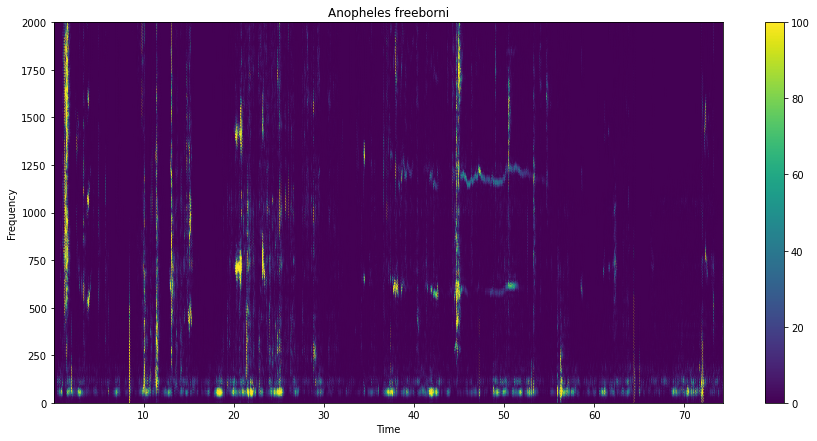

In [ ]:
plt.figure(figsize= (15, 7))
plt.pcolormesh(t_list[200], f_list[200], sg_list[200], vmin=0, vmax = 100, shading= 'gouraud')
plt.xlabel('Time')
plt.ylabel('Frequency')
plt.colorbar()
plt.title(str(y_list[200]))

Audio(data = audio_list[200], rate= target_sr)
#The specie seems to propogate similar sound frequencies around 550 and 1250 (possibly even 1750) (Hz). We can see visual noise when the recorder walks and this one seems to capture a lot
#less of the mosquito flying. The corresponding specie with the image is Anopheles Freeborni.

#### Summarizing the frequency patterns over time

- For each frequency bin in `sg_list` I've calculated its mean and standard deviation over time using a list comprehension.
- Assigned the resulting lists to the variable names `freqbin_mean_list` and `freqbin_sd_list`.
- Created numpy arrays from each list and concatenated them together into a single array called `X` of shape `[272, 498]`.



In [ ]:
freqbin_mean_list = np.array([i.mean(axis = 1) for i in sg_list]) #Finding the mean via list comprehension.
freqbin_sd_list = np.array([i.std(axis = 1) for i in sg_list]) #Finding Sd across the time columns.

#for i in sg_list:
X = np.concatenate((freqbin_mean_list, freqbin_sd_list), axis = 1)
X.shape

(272, 502)

#### 1.e. Converting `y_list` to a NumPy array

In [ ]:
ylist = np.array(y_list)


#### Spliting train and test data using stratified sampling

- I encode `y` using SciKit Learn's `LabelEncoder()`.
- Within my stratified sampler, I've include 60% of my data in the train set
- Assigning the outputs as:
 - `X_train_strat`
 - `X_test_strat`
 - `y_train_strat`
 - `y_test_strat`

In [ ]:
enc = LabelEncoder()
enc.fit(ylist)
y_enc = enc.transform(ylist) #Transforming categorical variables to numeric values.

In [ ]:
X_train_strat, X_test_strat, y_train_strat, y_test_strat = train_test_split(X, y_enc, stratify = y_enc, train_size = .6 ) #Assorting training and testing sample size.

#### Fitting a multinomial logistic regression model to predict mosquito species from the summarized frequency matrix
- I standardize `X_train_strat` by subtracting the mean of the columns and dividing by the standard deviation and the columns. I've assigned this variable to `X_train_strat_c` and have done the same for `X_test_strat` using the mean and standard deviation of `X_train_strat` and assigned this variable to `X_test_strat_c`.
- I use `max_iter=5000` within my  `LogisticRegression()` function in order to avoid non-convergence as frequently.
- I used `RFECV` with stratified 5-fold cross validation.
 - And `step=10` and `min_features_to_select=10` to speed up the process of feature selection
- Within my  `StratifiedKFold()` function, I use a random_state value of `0` which requires that `shuffle=True`.
- I then fit a model to the train data using the best model found via `RFECV`
- Predict on the train and test data
- And calculate the overall accuracy and plot the confusion matrix for the train and test sets.

*The Culiseta incidens species is predicted the worst in this model, folled by the Anopheles gambiae species. The Anopheles freeborni species has the best ratio of prediction.*

In [ ]:
X_train_strat_c = (X_train_strat - X_train_strat.mean(axis = 0))/(X_train_strat.std(axis = 0)) #Standardizing training and testing data.
X_test_strat_c = (X_test_strat - X_train_strat.mean(axis = 0))/(X_train_strat.std(axis = 0))

In [ ]:
lgm = LogisticRegression(max_iter=5000) #Logistic regression
skf = StratifiedKFold(n_splits= 5, shuffle = True, random_state = 0)
selector = RFECV(lgm, step= 10, min_features_to_select=10, cv = skf)
selector.fit(X_train_strat_c, y_train_strat) #Fitting the model

best_idx = np.where(selector.get_support())[0]# finding indicies of the best features for our model.

lgm_best = LogisticRegression(max_iter=5000)
lgm_best.fit(X_train_strat_c[:, best_idx], y_train_strat)


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=5000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [ ]:
X_train_strat_c[:,best_idx].shape

(163, 232)

Training Accuracy 0.8957055214723927


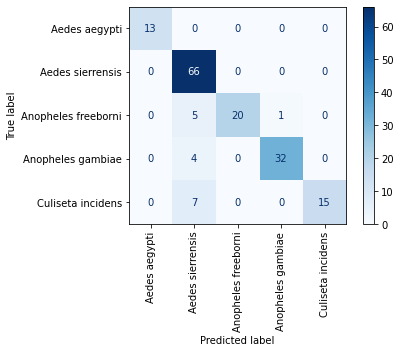

In [ ]:
y_train_pred = lgm_best.predict(X_train_strat_c[:, best_idx]) #Training data yhat using the 10 best functions.
print('Training Accuracy ' + str(accuracy_score(y_train_strat, y_train_pred)))
plot_confusion_matrix(lgm_best, X_train_strat_c[:,best_idx], y_train_strat, cmap= 'Blues', display_labels= enc.classes_, xticks_rotation= 'vertical');


Testing Accuracy 0.7614678899082569


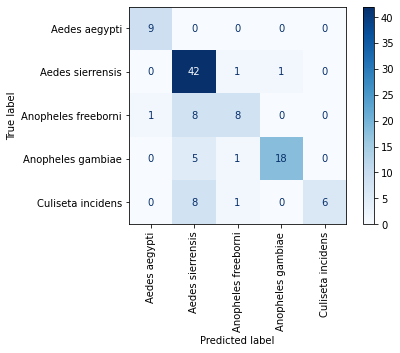

In [ ]:
y_test_pred = lgm_best.predict(X_test_strat_c[:, best_idx]) #Predicting yhat for the logistic regression model.
print('Testing Accuracy ' + str(accuracy_score(y_test_strat, y_test_pred)))
plot_confusion_matrix(lgm_best, X_test_strat_c[:,best_idx], y_test_strat, cmap= 'Blues', display_labels= enc.classes_, xticks_rotation= 'vertical')

#The Culiseta incidens species is predicted the worst in this model, folled by the Anopheles gambiae species. The Anopheles freeborni species has the best
#ratio of prediction.

#### Fitting the K-nearest neighbors model to predict mosquito species from the summarized frequency matrix

- I conduct a hyperparameter search using `GridSearchCV()` with stratified 10-fold cross validation on the following hyperparameters:
 - `n_neighbors`: 1 through 11, odd numbers
 - `leaf_size`: 1 through 5, by 1
 - `p`: Searching w/ both Manhattan and Euclidean distance.
- Print the best hyperparameters that were found by `GridSearchCV()`
- Within my `StratifiedKFold()` function, I again use a random_state value of `0` which requires that `shuffle=True`.
- After fitting a model to the train data using the best model found via `GridSearchCV()` I predict on train & test data.
- And calculate the overall accuracy and plot the confusion matrix for the train and test sets.

*Over all, the KNN function predicts better than the logistic function. The Aedes sierrensis species is predicted slightly worse, but the Culiseta incidens species see a massive improvement in prediction. In the KNN model, Anopheles freeborni has the best ratio of prediction, and the Anopheles gambiae species has the worst ratio of prediction.*

In [ ]:
list(np.arange(1, 5))

[1, 2, 3, 4]

In [ ]:
#k nearest neighbors to search

n_neighbors = list(range(1, 13,2))
# Parameter associated with breadth of search
leaf_size = list(np.arange(1, 6))
# Manhattan versus euclidean distance
p = [1, 2]

hyperparameters = dict(leaf_size=leaf_size, n_neighbors=n_neighbors, p=p)
knn = KNeighborsClassifier() #KNN model
skf = StratifiedKFold(n_splits= 10, shuffle = True, random_state = 0)
clf = GridSearchCV(knn, hyperparameters, cv=skf)
#Fit the model
knn_best = clf.fit(X_train_strat_c, y_train_strat) #Fitting the model
print('Best leaf_size:', knn_best.best_estimator_.get_params()['leaf_size'])
print('Best p:', knn_best.best_estimator_.get_params()['p'])
print('Best n_neighbors:', knn_best.best_estimator_.get_params()['n_neighbors'])


Best leaf_size: 1
Best p: 1
Best n_neighbors: 1


Training Accuracy 1.0


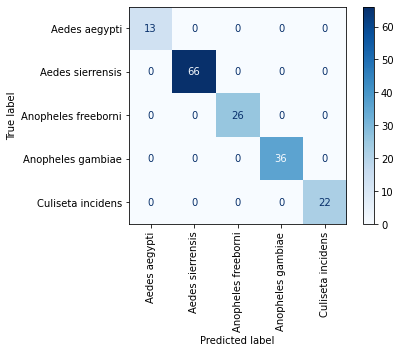

In [ ]:
# Make predictions on stratified sampled data
y_train_pred = knn_best.predict(X_train_strat_c)

print('Training Accuracy ' + str(accuracy_score(y_train_strat, y_train_pred)))

plot_confusion_matrix(knn_best, X_train_strat_c, y_train_strat, cmap= 'Blues', display_labels= enc.classes_, xticks_rotation= 'vertical')

Testing OOS Accuracy 0.8715596330275229


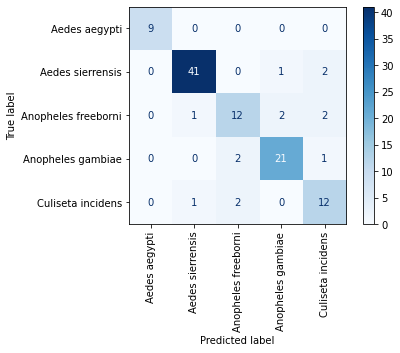

In [ ]:
# Make predictions on stratified sampled data
y_test_pred = knn_best.predict(X_test_strat_c)

print('Testing OOS Accuracy ' + str(accuracy_score(y_test_strat, y_test_pred)))

plot_confusion_matrix(knn_best, X_test_strat_c, y_test_strat, cmap= 'Blues', display_labels= enc.classes_, xticks_rotation= 'vertical')

##Over all, the KNN function predicts better than the logistic function. The Aedes sierrensis species is predicted slightly worse, but the Culiseta incidens species
#see a massive improvement in prediction. In the KNN model, Anopheles freeborni has the best ratio of prediction, and the Anopheles gambiae species has the worst
#ratio of prediction.


In [ ]:
y_test_strat.shape

(109,)

#### Fitting a Random Forest model to predict mosquito species from the summarized frequency matrix

- I use the standardized variables, `X_train_strat_c` and `X_test_strat_c` as inputs.
- And conduct a hyperparameter search using `GridSearchCV()` with stratified 10-fold cross validation on the following hyperparameters:
 - `n_estimators`: 25, 50, 100, and 200
 - `max_depth`: None, 2, 5, 10
 - `min_samples_split`: 2 and 5
 - `min_samples_leaf`: 1 and 3
- I've print the best hyperparameters that were found by `GridSearchCV()`
- I again use a random_state value of `0` in my `StratifiedKFold()` function which requires that `shuffle=True`.
- Finally fit the model to the train data using the best model found via `GridSearchCV()` and predict on the train and test data.

*After calculating the overall accuracy and plot the confusion matrix for the train and test sets I noticed the following; the random forest model predicts the Anopheles gambiae species the worst, followed by the Culiseta incidens species. The Aedes aegypti species is predicted the best.*

In [ ]:

# Maximum number of levels in tree
max_depth = [2, 5, 10]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2,5]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1,3]
# Create grid for grid search
hyperparameters = {'max_depth': max_depth,
                   'min_samples_split': min_samples_split,
                   'min_samples_leaf': min_samples_leaf}
# Create a new random forest object
rf = RandomForestClassifier(random_state= 0)
skf = StratifiedKFold(n_splits=10, shuffle= True, random_state= 0)
#Use GridSearch
clf = GridSearchCV(rf, hyperparameters, cv=skf)
rf_best = clf.fit(X_train_strat_c, y_train_strat)


rf_best.best_params_



{'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 2}

training accuracy = 1.0


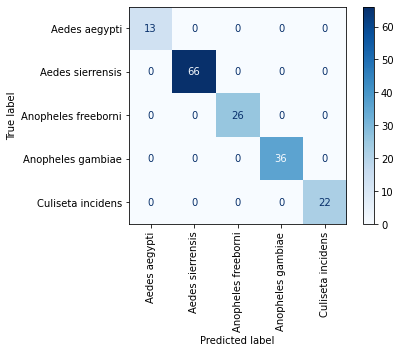

In [ ]:
y_train_pred = rf_best.predict(X_train_strat_c)

print('training accuracy = ' + str(accuracy_score(y_train_strat, y_train_pred)))
plot_confusion_matrix(rf_best, X_train_strat_c, y_train_strat, cmap= 'Blues', display_labels= enc.classes_, xticks_rotation= 'vertical')


testing accuracy = 0.8715596330275229


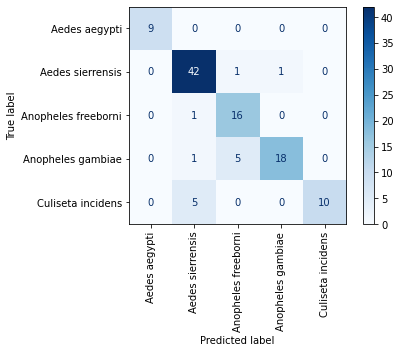

In [ ]:

y_test_predi = rf_best.predict(X_test_strat_c)

print('testing accuracy = ' + str(accuracy_score(y_test_strat, y_test_predi)))
plot_confusion_matrix(rf_best, X_test_strat_c, y_test_strat, cmap= 'Blues', display_labels= enc.classes_, xticks_rotation= 'vertical')

#The random forest model predicts the Anopheles gambiae species the worst, followed by the Culiseta incidens species. The Aedes aegypti species is predicted the best.



#### *In terms of what model performs best on the test set in terms of overall accuracy, that of the KNN and Random Forest models are tied for the best out of sample performance with a testing accuracy of 0.8715596330275229*

In [ ]:
#The accuracy of the KNN and Random Forest models are tied for the best out of sample performance with a testing accuracy of 0.8715596330275229.